<center>
<h2>
Part 2. Bernoulli Bandits
</h2>
</center>

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from code.bandits import BernoulliBandit
from code.algorithms import FTL, UCB, UCB_V, kl_UCB
from code.visualization import *

In [2]:
save_fig_flag = False

Question 1a

see `report.pdf`

Question 1b

see `algorithms.py`

Question 1c

In [13]:
K = 2
T = 1000
n = 1000
probs = [0.5, 0.6]

bern_bandit = BernoulliBandit(K, probs)
ftl = FTL(bern_bandit)

In [14]:
ftl_regrets = []
ftl_cum_regrets = np.zeros((n,T))
for i in range(n):
    ftl.reset()
    ftl.run(T, n_run=i, ntot_run=n)
    ftl_regrets.append(ftl.regret)
    ftl_cum_regrets[i] = ftl.cum_regret

run 2/100 | running step 560/1000

run 4/100 | running step 60/1000

run 5/100 | running step 559/1000

run 7/100 | running step 59/1000

run 8/100 | running step 558/1000

run 10/100 | running step 58/1000

run 11/100 | running step 557/1000

run 13/100 | running step 57/1000

run 14/100 | running step 556/1000

run 16/100 | running step 56/1000

run 17/100 | running step 555/1000

run 19/100 | running step 55/1000

run 20/100 | running step 554/1000

run 22/100 | running step 54/1000

run 23/100 | running step 553/1000

run 25/100 | running step 53/1000

run 26/100 | running step 552/1000

run 28/100 | running step 52/1000

run 29/100 | running step 420/1000

run 30/100 | running step 369/1000

run 31/100 | running step 550/1000

run 32/100 | running step 792/1000

run 33/100 | running step 737/1000

run 34/100 | running step 801/1000

run 36/100 | running step 52/1000

run 37/100 | running step 220/1000

run 38/100 | running step 516/1000

run 39/100 | running step 786/1000

run 40/100 | running step 874/1000

run 41/100 | running step 752/1000

run 42/100 | running step 839/1000

run 44/100 | running step 386/1000

run 45/100 | running step 159/1000

run 46/100 | running step 124/1000

run 47/100 | running step 543/1000

run 48/100 | running step 692/1000

run 50/100 | running step 42/1000

run 51/100 | running step 542/1000

run 53/100 | running step 41/1000

run 54/100 | running step 41/1000

run 55/100 | running step 40/1000

run 56/100 | running step 40/1000

run 57/100 | running step 39/1000

run 58/100 | running step 114/1000

run 59/100 | running step 74/1000

run 60/100 | running step 173/1000

run 61/100 | running step 42/1000

run 62/100 | running step 258/1000

run 63/100 | running step 536/1000

run 64/100 | running step 681/1000

run 66/100 | running step 35/1000

run 67/100 | running step 35/1000

run 68/100 | running step 304/1000

run 69/100 | running step 560/1000

run 70/100 | running step 462/1000

run 71/100 | running step 576/1000

run 72/100 | running step 581/1000

run 73/100 | running step 643/1000

run 74/100 | running step 831/1000

run 75/100 | running step 827/1000

run 77/100 | running step 48/1000

run 78/100 | running step 107/1000

run 79/100 | running step 188/1000

run 79/100 | running step 866/1000

run 80/100 | running step 758/1000

run 81/100 | running step 775/1000

run 82/100 | running step 677/1000

run 84/100 | running step 27/1000

run 85/100 | running step 526/1000

run 87/100 | running step 26/1000

run 88/100 | running step 525/1000

run 90/100 | running step 25/1000

run 91/100 | running step 524/1000

run 93/100 | running step 24/1000

run 94/100 | running step 523/1000

run 96/100 | running step 23/1000

run 97/100 | running step 522/1000

run 98/100 | running step 939/1000

run 100/100 | running step 21/1000

run 100/100 | running step 1000/1000

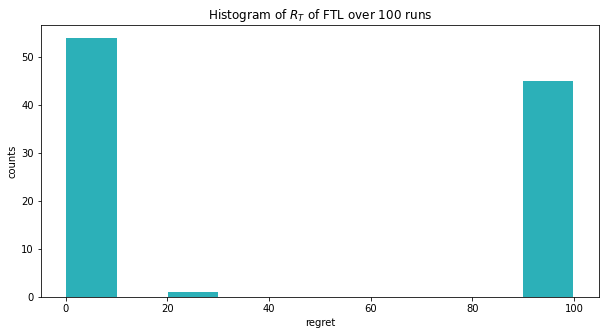

In [15]:
plot_regret_hist(ftl_regrets, save_fig=save_fig_flag, algo='FTL')

either suffers a null regret as the first pull of the each arm gave 1 for the best arm and 0 for the worse.<br>
or suffers a high regret (0.1 * 100 = 10) as the first pull of the each arm gave 0 for the best arm and 1 for the worse: keeps pulling the worse arm whose $\mu$ estimates will always be bigger than 0.

Question 1d

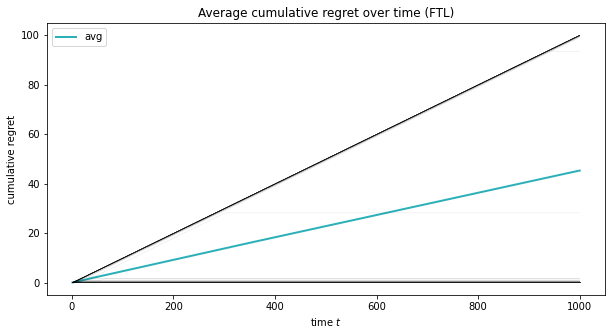

In [23]:
plot_mean_regret(ftl_cum_regrets, alpha=0.1, save_fig=save_fig_flag, title='Average cumulative regret over time', algo='FTL')

we see the linear dependance in time as a mean of the 2 edges cases we talked about in the previous question (new slope is $\frac{0 + \alpha}{2}$)

FTL is **not** a good algorithm for stochastic bandits because of the previoulsy higlighted linear dependance in T

Question 2a to 2e

see `report.pdf`

Question 2f

see `algorithms.py`

Question 2g

In [17]:
K = 2
T = 1000
n = 1000
probs = [0.5, 0.6]
sigma_square = 1./4

bern_bandit = BernoulliBandit(K, probs)
ucb = UCB(bern_bandit, sigma_square)

In [18]:
ucb_regrets = []
ucb_cum_regrets = np.zeros((n,T))
for i in range(n):
    ucb.reset()
    ucb.run(T, n_run=i, ntot_run=n)
    ucb_regrets.append(ucb.regret)
    ucb_cum_regrets[i] = ucb.cum_regret

run 2/100 | running step 493/1000

run 3/100 | running step 976/1000

run 4/100 | running step 493/1000

run 5/100 | running step 492/1000

run 6/100 | running step 491/1000

run 7/100 | running step 695/1000

run 8/100 | running step 887/1000

run 9/100 | running step 714/1000

run 10/100 | running step 989/1000

run 12/100 | running step 443/1000

run 13/100 | running step 488/1000

run 14/100 | running step 970/1000

run 15/100 | running step 987/1000

run 16/100 | running step 987/1000

run 17/100 | running step 677/1000

run 18/100 | running step 577/1000

run 19/100 | running step 746/1000

run 20/100 | running step 948/1000

run 21/100 | running step 626/1000

run 22/100 | running step 656/1000

run 23/100 | running step 830/1000

run 24/100 | running step 583/1000

run 25/100 | running step 384/1000

run 26/100 | running step 5/1000

run 27/100 | running step 68/1000

run 28/100 | running step 481/1000

run 29/100 | running step 980/1000

run 31/100 | running step 243/1000

run 32/100 | running step 188/1000

run 33/100 | running step 63/1000

run 33/100 | running step 978/1000

run 35/100 | running step 98/1000

run 36/100 | running step 303/1000

run 37/100 | running step 366/1000

run 38/100 | running step 476/1000

run 39/100 | running step 944/1000

run 40/100 | running step 975/1000

run 42/100 | running step 405/1000

run 43/100 | running step 474/1000

run 44/100 | running step 870/1000

run 45/100 | running step 973/1000

run 47/100 | running step 202/1000

run 48/100 | running step 415/1000

run 49/100 | running step 521/1000

run 50/100 | running step 680/1000

run 51/100 | running step 834/1000

run 52/100 | running step 848/1000

run 54/100 | running step 237/1000

run 55/100 | running step 469/1000

run 56/100 | running step 969/1000

run 58/100 | running step 445/1000

run 59/100 | running step 468/1000

run 60/100 | running step 967/1000

run 62/100 | running step 456/1000

run 63/100 | running step 466/1000

run 64/100 | running step 674/1000

run 65/100 | running step 898/1000

run 66/100 | running step 965/1000

run 68/100 | running step 108/1000

run 69/100 | running step 58/1000

run 70/100 | running step 49/1000

run 71/100 | running step 353/1000

run 72/100 | running step 194/1000

run 73/100 | running step 259/1000

run 74/100 | running step 293/1000

run 75/100 | running step 287/1000

run 76/100 | running step 168/1000

run 77/100 | running step 337/1000

run 78/100 | running step 307/1000

run 79/100 | running step 29/1000

run 79/100 | running step 855/1000

run 81/100 | running step 458/1000

run 82/100 | running step 506/1000

run 83/100 | running step 457/1000

run 84/100 | running step 956/1000

run 86/100 | running step 456/1000

run 87/100 | running step 955/1000

run 89/100 | running step 455/1000

run 90/100 | running step 454/1000

run 91/100 | running step 454/1000

run 92/100 | running step 650/1000

run 93/100 | running step 842/1000

run 94/100 | running step 759/1000

run 95/100 | running step 719/1000

run 96/100 | running step 622/1000

run 97/100 | running step 585/1000

run 98/100 | running step 401/1000

run 99/100 | running step 180/1000

run 100/100 | running step 317/1000

run 100/100 | running step 1000/1000

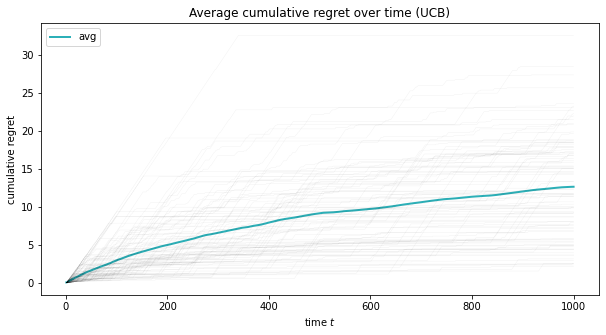

In [24]:
plot_mean_regret(ucb_cum_regrets, alpha=0.05, save_fig=save_fig_flag, save_name='p2_2g', title='Average cumulative regret over time', algo='UCB')

In [20]:
regret_dict = {
    'FTL': [ftl_cum_regrets, '#53B3CD'],
    'UCB': [ucb_cum_regrets, '#3A6FB6']
}

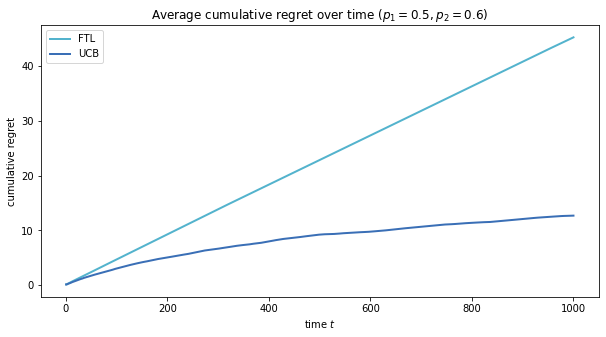

In [21]:
title = 'Average cumulative regret over time ($p_1 = 0.5, p_2 = 0.6$)'
plot_multiple_avg_regrets(regret_dict, save_fig=save_fig_flag, title=title)

Question 2h

In [8]:
K = 2
T = 1000
n = 1000
sigma_squares = [0, 1./32, 1./16, 1./4, 1.]

In [9]:
probs_1 = [0.6, 0.5]
bern_bandit_1 = BernoulliBandit(K, probs_1)

In [10]:
m = len(sigma_squares)
ucb1_sigma_regrets = np.zeros((n,m))
for j, sigma_square in enumerate(sigma_squares):
    print(f'sigma: {j+1}/{m}')
    ucb1 = UCB(bern_bandit_1, sigma_square)
    for i in range(n):
        ucb1.reset()
        ucb1.run(T, n_run=i, ntot_run=n)
        ucb1_sigma_regrets[i,j] = ucb1.regret
    print()

sigma: 1/5


run 3/100 | running step 903/1000

run 4/100 | running step 430/1000

run 5/100 | running step 430/1000

run 6/100 | running step 429/1000

run 7/100 | running step 555/1000

run 8/100 | running step 428/1000

run 9/100 | running step 428/1000

run 10/100 | running step 427/1000

run 11/100 | running step 477/1000

run 12/100 | running step 426/1000

run 13/100 | running step 473/1000

run 14/100 | running step 425/1000

run 15/100 | running step 478/1000

run 16/100 | running step 715/1000

run 17/100 | running step 610/1000

run 18/100 | running step 448/1000

run 19/100 | running step 487/1000

run 20/100 | running step 390/1000

run 21/100 | running step 131/1000

run 21/100 | running step 974/1000

run 22/100 | running step 820/1000

run 23/100 | running step 830/1000

run 24/100 | running step 478/1000

run 25/100 | running step 862/1000

run 26/100 | running step 419/1000

run 27/100 | running step 418/1000

run 28/100 | running step 418/1000

run 29/100 | running step 417/1000

run 30/100 | running step 417/1000

run 30/100 | running step 995/1000

run 31/100 | running step 916/1000

run 32/100 | running step 915/1000

run 33/100 | running step 610/1000

run 34/100 | running step 414/1000

run 35/100 | running step 414/1000

run 36/100 | running step 413/1000

run 37/100 | running step 294/1000

run 38/100 | running step 51/1000

run 38/100 | running step 849/1000

run 39/100 | running step 282/1000

run 40/100 | running step 235/1000

run 41/100 | running step 323/1000

run 42/100 | running step 571/1000

run 43/100 | running step 566/1000

run 44/100 | running step 768/1000

run 45/100 | running step 652/1000

run 46/100 | running step 408/1000

run 47/100 | running step 407/1000

run 48/100 | running step 402/1000

run 100/100 | running step 1000/1000
sigma: 2/5
run 100/100 | running step 1000/1000
sigma: 3/5
run 100/100 | running step 1000/1000
sigma: 4/5
run 100/100 | running step 1000/1000
sigma: 5/5
run 100/100 | running step 1000/1000


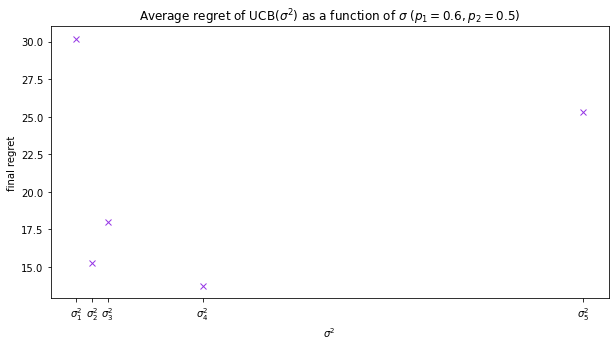

In [11]:
title = 'Average regret of UCB($\sigma^2$) as a function of $\sigma$ ($p_1 = 0.6, p_2 = 0.5$)'
plot_final_regret_sigma_square(ucb1_sigma_regrets, sigma_squares, save_fig=save_fig_flag, save_name='p2_2h_1', title=title)

In [12]:
probs_2 = [0.85, 0.95]
bern_bandit_2 = BernoulliBandit(K, probs_2)

In [13]:
m = len(sigma_squares)
ucb2_sigma_regrets = np.zeros((n,m))
for j, sigma_square in enumerate(sigma_squares):
    print(f'sigma: {j+1}/{m}')
    ucb2 = UCB(bern_bandit_2, sigma_square)
    for i in range(n):
        ucb2.reset()
        ucb2.run(T, n_run=i, ntot_run=n)
        ucb2_sigma_regrets[i,j] = ucb2.regret
    print()

sigma: 1/5


run 3/100 | running step 179/1000

run 4/100 | running step 216/1000

run 5/100 | running step 479/1000

run 6/100 | running step 256/1000

run 7/100 | running step 533/1000

run 8/100 | running step 575/1000

run 9/100 | running step 344/1000

run 10/100 | running step 544/1000

run 11/100 | running step 550/1000

run 12/100 | running step 543/1000

run 13/100 | running step 421/1000

run 14/100 | running step 150/1000

run 15/100 | running step 220/1000

run 16/100 | running step 291/1000

run 17/100 | running step 196/1000

run 18/100 | running step 149/1000

run 18/100 | running step 485/1000

run 19/100 | running step 533/1000

run 20/100 | running step 647/1000

run 21/100 | running step 646/1000

run 22/100 | running step 646/1000

run 23/100 | running step 645/1000

run 24/100 | running step 541/1000

run 25/100 | running step 513/1000

run 26/100 | running step 501/1000

run 27/100 | running step 143/1000

run 28/100 | running step 351/1000

run 29/100 | running step 217/1000

run 30/100 | running step 322/1000

run 30/100 | running step 998/1000

run 31/100 | running step 902/1000

run 32/100 | running step 933/1000

run 33/100 | running step 640/1000

run 34/100 | running step 774/1000

run 35/100 | running step 679/1000

run 36/100 | running step 488/1000

run 37/100 | running step 354/1000

run 38/100 | running step 495/1000

run 39/100 | running step 154/1000

run 39/100 | running step 885/1000

run 40/100 | running step 953/1000

run 42/100 | running step 135/1000

run 43/100 | running step 500/1000

run 44/100 | running step 134/1000

run 45/100 | running step 134/1000

run 46/100 | running step 133/1000

run 47/100 | running step 133/1000

run 47/100 | running step 407/1000

run 48/100 | running step 291/1000

run 49/100 | running step 228/1000

run 50/100 | running step 131/1000

run 50/100 | running step 630/1000

run 50/100 | running step 931/1000

run 51/100 | running step 855/1000

run 52/100 | running step 629/1000

run 53/100 | running step 201/1000

run 53/100 | running step 628/1000

run 100/100 | running step 1000/1000
sigma: 2/5
run 100/100 | running step 1000/1000
sigma: 3/5
run 100/100 | running step 1000/1000
sigma: 4/5
run 100/100 | running step 1000/1000
sigma: 5/5
run 100/100 | running step 1000/1000


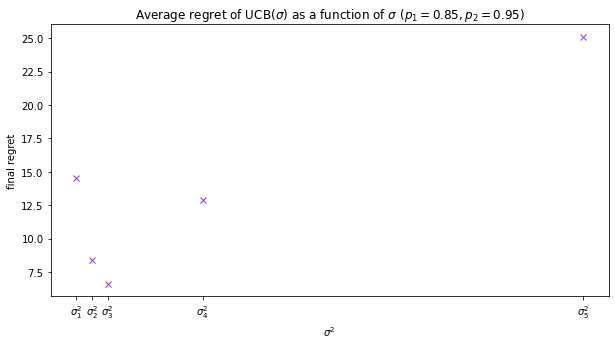

In [14]:
title = 'Average regret of UCB($\sigma$) as a function of $\sigma$ ($p_1 = 0.85, p_2 = 0.95$)'
plot_final_regret_sigma_square(ucb2_sigma_regrets, sigma_squares, save_fig=save_fig_flag, save_name='p2_2h_2', title=title)

Question 3

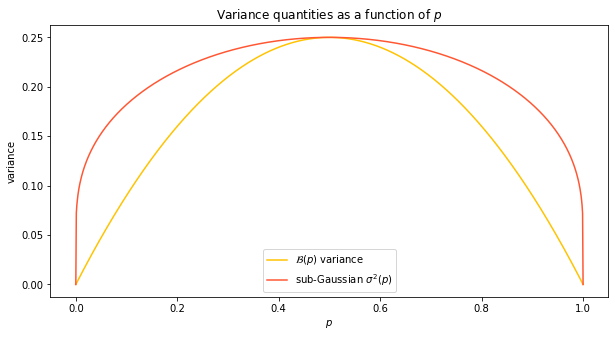

In [15]:
from code.utils import bernoulli_var, sub_gaussian_sigma

p_val = np.arange(0, 1.001, 0.001)

plt.figure(figsize=(10,5))
plt.plot(p_val, [bernoulli_var(p) for p in p_val], color='#FFC300', label='$\mathcal{B}(p)$ variance')
plt.plot(p_val, [sub_gaussian_sigma(p) for p in p_val], color='#FF5733', label='sub-Gaussian $\sigma^2(p)$')
plt.xlabel(f'$p$')
plt.ylabel(f'variance')
plt.title(f'Variance quantities as a function of $p$')
plt.legend()
if save_fig_flag:
    plt.savefig(f'p2_3.pdf')
plt.show()

Question 5a & 5b

see `report.pdf`

Question 5c

see `algorithms.py`

Question 5d

In [16]:
K = 2
T = 1000
n = 1000
probs = [0.5, 0.6]
sigma_square = 1./4
b = 1
ksi = 1.2
c = 1

bern_bandit = BernoulliBandit(K, probs)
ucb = UCB(bern_bandit, sigma_square)
ucb_v = UCB_V(bern_bandit, b, ksi, c)

In [17]:
ucb_regrets = []
ucb_cum_regrets = np.zeros((n,T))
for i in range(n):
    ucb.reset()
    ucb.run(T, n_run=i, ntot_run=n)
    ucb_regrets.append(ucb.regret)
    ucb_cum_regrets[i] = ucb.cum_regret

run 2/100 | running step 247/1000

run 2/100 | running step 747/1000

run 3/100 | running step 746/1000

run 4/100 | running step 437/1000

run 4/100 | running step 745/1000

run 5/100 | running step 525/1000

run 6/100 | running step 101/1000

run 100/100 | running step 1000/1000

In [18]:
ucb_v_regrets = []
ucb_v_cum_regrets = np.zeros((n,T))
for i in range(n):
    ucb_v.reset()
    ucb_v.run(T, n_run=i, ntot_run=n)
    ucb_v_regrets.append(ucb_v.regret)
    ucb_v_cum_regrets[i] = ucb_v.cum_regret

run 1/100 | running step 690/1000

run 100/100 | running step 1000/1000

In [19]:
regret_dict = {
    'UCB': [ucb_cum_regrets, '#3A6FB6'],
    'UCB-V': [ucb_v_cum_regrets, '#413AD0'],
}

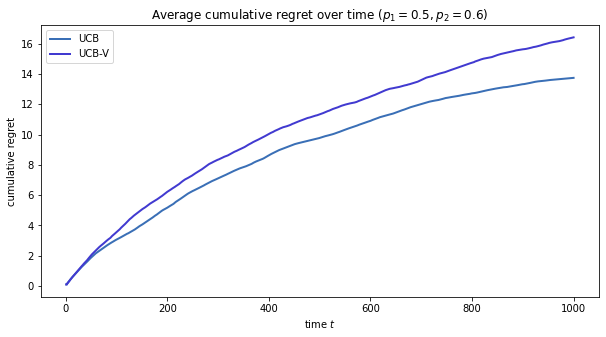

In [20]:
title = 'Average cumulative regret over time ($p_1 = 0.5, p_2 = 0.6$)'
plot_multiple_avg_regrets(regret_dict, save_fig=save_fig_flag, save_name='p2_5d', title=title)

Question 5e

In [21]:
probs1 = [0.1, 0.2]
bern_bandit1 = BernoulliBandit(K, probs1)
ucb1 = UCB(bern_bandit1, sigma_square)
ucb_v1 = UCB_V(bern_bandit1, b, ksi, c)

In [22]:
ucb1_regrets = []
ucb1_cum_regrets = np.zeros((n,T))
for i in range(n):
    ucb1.reset()
    ucb1.run(T, n_run=i, ntot_run=n)
    ucb1_regrets.append(ucb1.regret)
    ucb1_cum_regrets[i] = ucb1.cum_regret

running step 585/1000

running step 584/1000

running step 584/1000

running step 631/1000

running step 583/1000

running step 786/1000

running step 971/1000

running step 81/1000

running step 228/1000

running step 415/1000

running step 580/1000

running step 51/1000

running step 79/1000

running step 544/1000

running step 578/1000

running step 937/1000

running step 76/1000

running step 995/1000

running step 884/1000

running step 474/1000

running step 424/1000

running step 305/1000

running step 894/1000

running step 73/1000

running step 73/1000

running step 510/1000

running step 506/1000

running step 71/1000

running step 571/1000

running step 702/1000

running step 570/1000

running step 630/1000

running step 569/1000

running step 568/1000

running step 568/1000

running step 567/1000

running step 701/1000

running step 667/1000

running step 911/1000

running step 7/1000

running step 65/1000

running step 126/1000

running step 26/1000

running step 841/1000

running step 447/1000

running step 1000/1000

In [23]:
ucb_v1_regrets = []
ucb_v1_cum_regrets = np.zeros((n,T))
for i in range(n):
    ucb_v1.reset()
    ucb_v1.run(T, n_run=i, ntot_run=n)
    ucb_v1_regrets.append(ucb_v1.regret)
    ucb_v1_cum_regrets[i] = ucb_v1.cum_regret

run 1/100 | running step 530/1000

run 3/100 | running step 30/1000

run 4/100 | running step 128/1000

run 5/100 | running step 207/1000

run 6/100 | running step 84/1000

run 7/100 | running step 84/1000

run 8/100 | running step 252/1000

run 9/100 | running step 227/1000

run 10/100 | running step 26/1000

run 10/100 | running step 526/1000

run 11/100 | running step 25/1000

run 11/100 | running step 868/1000

run 12/100 | running step 630/1000

run 13/100 | running step 680/1000

run 14/100 | running step 523/1000

run 15/100 | running step 529/1000

run 16/100 | running step 447/1000

run 17/100 | running step 388/1000

run 18/100 | running step 47/1000

run 18/100 | running step 961/1000

run 19/100 | running step 785/1000

run 20/100 | running step 952/1000

run 22/100 | running step 19/1000

run 23/100 | running step 340/1000

run 24/100 | running step 217/1000

run 25/100 | running step 218/1000

run 26/100 | running step 201/1000

run 27/100 | running step 204/1000

run 28/100 | running step 95/1000

run 29/100 | running step 130/1000

run 30/100 | running step 165/1000

run 31/100 | running step 334/1000

run 32/100 | running step 456/1000

run 33/100 | running step 506/1000

run 34/100 | running step 435/1000

run 35/100 | running step 331/1000

run 36/100 | running step 204/1000

run 37/100 | running step 12/1000

run 37/100 | running step 895/1000

run 38/100 | running step 339/1000

run 39/100 | running step 287/1000

run 39/100 | running step 965/1000

run 41/100 | running step 9/1000

run 42/100 | running step 86/1000

run 43/100 | running step 9/1000

run 44/100 | running step 8/1000

run 45/100 | running step 179/1000

run 46/100 | running step 7/1000

run 47/100 | running step 345/1000

run 48/100 | running step 250/1000

run 49/100 | running step 68/1000

run 50/100 | running step 5/1000

run 51/100 | running step 4/1000

run 52/100 | running step 214/1000

run 53/100 | running step 3/1000

run 53/100 | running step 503/1000

run 54/100 | running step 503/1000

run 55/100 | running step 502/1000

run 56/100 | running step 437/1000

run 57/100 | running step 501/1000

run 58/100 | running step 406/1000

run 59/100 | running step 334/1000

run 60/100 | running step 235/1000

run 61/100 | running step 69/1000

run 61/100 | running step 906/1000

run 63/100 | running step 498/1000

run 64/100 | running step 578/1000

run 65/100 | running step 682/1000

run 66/100 | running step 375/1000

run 67/100 | running step 69/1000

run 67/100 | running step 929/1000

run 68/100 | running step 919/1000

run 69/100 | running step 892/1000

run 70/100 | running step 994/1000

run 72/100 | running step 137/1000

run 72/100 | running step 633/1000

run 72/100 | running step 992/1000

run 73/100 | running step 706/1000

run 74/100 | running step 491/1000

run 75/100 | running step 96/1000

run 75/100 | running step 493/1000

run 76/100 | running step 442/1000

run 76/100 | running step 950/1000

run 77/100 | running step 286/1000

run 77/100 | running step 546/1000

run 78/100 | running step 488/1000

run 100/100 | running step 1000/1000

In [24]:
regret_dict1 = {
    'UCB': [ucb1_cum_regrets, '#3A6FB6'],
    'UCB-V': [ucb_v1_cum_regrets, '#413AD0'],
}

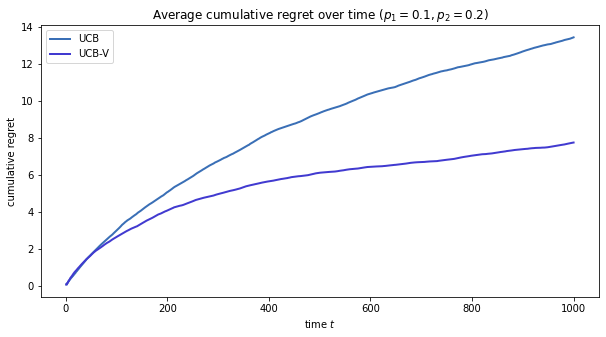

In [25]:
title = 'Average cumulative regret over time ($p_1 = 0.1, p_2 = 0.2$)'
plot_multiple_avg_regrets(regret_dict1, save_fig=save_fig_flag, save_name='p2_5e_1', title=title)

In [26]:
probs2 = [0.0, 0.1]
bern_bandit2 = BernoulliBandit(K, probs2)
ucb2 = UCB(bern_bandit2, sigma_square)
ucb_v2 = UCB_V(bern_bandit2, b, ksi, c)

In [27]:
ucb2_regrets = []
ucb2_cum_regrets = np.zeros((n,T))
for i in range(n):
    ucb2.reset()
    ucb2.run(T, n_run=i, ntot_run=n)
    ucb2_regrets.append(ucb2.regret)
    ucb2_cum_regrets[i] = ucb2.cum_regret

run 2/100 | running step 448/1000

run 3/100 | running step 690/1000

run 4/100 | running step 416/1000

run 5/100 | running step 89/1000

run 5/100 | running step 964/1000

run 6/100 | running step 946/1000

run 7/100 | running step 945/1000

run 8/100 | running step 945/1000

run 10/100 | running step 45/1000

run 11/100 | running step 149/1000

run 12/100 | running step 40/1000

run 12/100 | running step 952/1000

run 13/100 | running step 877/1000

run 14/100 | running step 527/1000

run 15/100 | running step 549/1000

run 16/100 | running step 258/1000

run 16/100 | running step 766/1000

run 17/100 | running step 497/1000

run 18/100 | running step 291/1000

run 19/100 | running step 112/1000

run 19/100 | running step 685/1000

run 20/100 | running step 362/1000

run 20/100 | running step 967/1000

run 22/100 | running step 437/1000

run 23/100 | running step 353/1000

run 24/100 | running step 66/1000

run 24/100 | running step 935/1000

run 25/100 | running step 935/1000

run 26/100 | running step 780/1000

run 27/100 | running step 584/1000

run 28/100 | running step 433/1000

run 29/100 | running step 433/1000

run 30/100 | running step 754/1000

run 31/100 | running step 577/1000

run 32/100 | running step 431/1000

run 33/100 | running step 431/1000

run 33/100 | running step 930/1000

run 34/100 | running step 365/1000

run 34/100 | running step 970/1000

run 35/100 | running step 254/1000

run 35/100 | running step 592/1000

run 35/100 | running step 845/1000

run 36/100 | running step 146/1000

run 36/100 | running step 399/1000

run 100/100 | running step 1000/1000

In [28]:
ucb_v2_regrets = []
ucb_v2_cum_regrets = np.zeros((n,T))
for i in range(n):
    ucb_v2.reset()
    ucb_v2.run(T, n_run=i, ntot_run=n)
    ucb_v2_regrets.append(ucb_v2.regret)
    ucb_v2_cum_regrets[i] = ucb_v2.cum_regret

run 100/100 | running step 1000/1000

In [29]:
regret_dict2 = {
    'UCB': [ucb2_cum_regrets, '#3A6FB6'],
    'UCB-V': [ucb_v2_cum_regrets, '#413AD0'],
}

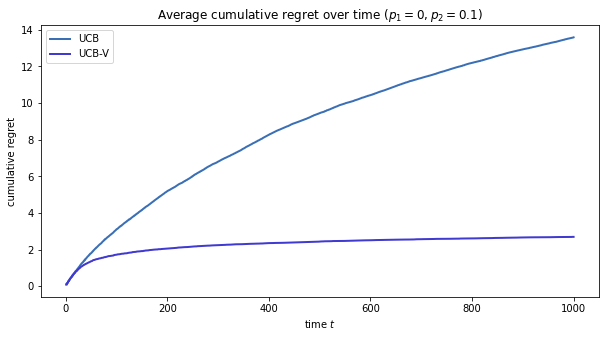

In [30]:
title = 'Average cumulative regret over time ($p_1 = 0, p_2 = 0.1$)'
plot_multiple_avg_regrets(regret_dict2, save_fig=save_fig_flag, save_name='p2_5e_2', title=title)

Question 6

see `algorithms.py`

In [31]:
K = 2
T = 1000
n = 1000
probs = [0.5, 0.6]
sigma_square = 1./4
b = 1
ksi = 1.2
c = 1

bern_bandit = BernoulliBandit(K, probs)
kl_ucb = kl_UCB(bern_bandit)

In [32]:
kl_ucb_regrets = []
kl_ucb_cum_regrets = np.zeros((n,T))
for i in range(n):
    kl_ucb.reset()
    kl_ucb.run(T, n_run=i, ntot_run=n)
    kl_ucb_regrets.append(kl_ucb.regret)
    kl_ucb_cum_regrets[i] = kl_ucb.cum_regret

run 1/100 | running step 888/1000

run 2/100 | running step 448/1000

run 2/100 | running step 840/1000

run 3/100 | running step 171/1000

run 3/100 | running step 646/1000

run 4/100 | running step 227/1000

run 4/100 | running step 794/1000

run 5/100 | running step 446/1000

run 5/100 | running step 821/1000

run 6/100 | running step 330/1000

run 6/100 | running step 941/1000

run 7/100 | running step 414/1000

run 7/100 | running step 713/1000

run 8/100 | running step 189/1000

run 9/100 | running step 16/1000

run 9/100 | running step 344/1000

run 9/100 | running step 921/1000

run 10/100 | running step 449/1000

run 10/100 | running step 980/1000

run 11/100 | running step 434/1000

run 11/100 | running step 928/1000

run 12/100 | running step 521/1000

run 12/100 | running step 857/1000

run 13/100 | running step 421/1000

run 13/100 | running step 956/1000

run 14/100 | running step 454/1000

run 14/100 | running step 850/1000

run 15/100 | running step 742/1000

run 16/100 | running step 283/1000

run 16/100 | running step 820/1000

run 17/100 | running step 394/1000

run 18/100 | running step 126/1000

run 18/100 | running step 719/1000

run 19/100 | running step 281/1000

run 19/100 | running step 973/1000

run 20/100 | running step 621/1000

run 21/100 | running step 279/1000

run 21/100 | running step 896/1000

run 22/100 | running step 560/1000

run 23/100 | running step 191/1000

run 23/100 | running step 764/1000

run 24/100 | running step 728/1000

run 25/100 | running step 276/1000

run 26/100 | running step 38/1000

run 26/100 | running step 717/1000

run 27/100 | running step 275/1000

run 28/100 | running step 74/1000

run 28/100 | running step 771/1000

run 29/100 | running step 339/1000

run 29/100 | running step 989/1000

run 30/100 | running step 554/1000

run 30/100 | running step 919/1000

run 31/100 | running step 546/1000

run 32/100 | running step 152/1000

run 32/100 | running step 486/1000

run 33/100 | running step 206/1000

run 33/100 | running step 769/1000

run 34/100 | running step 411/1000

run 34/100 | running step 878/1000

run 35/100 | running step 268/1000

run 35/100 | running step 984/1000

run 36/100 | running step 638/1000

run 37/100 | running step 182/1000

run 37/100 | running step 711/1000

run 38/100 | running step 372/1000

run 38/100 | running step 905/1000

run 39/100 | running step 483/1000

run 39/100 | running step 950/1000

run 40/100 | running step 316/1000

run 40/100 | running step 882/1000

run 100/100 | running step 1000/1000

In [33]:
regret_dict = {
    'UCB': [ucb_cum_regrets, '#3A6FB6'],
    'UCB-V': [ucb_v_cum_regrets, '#413AD0'],
    'kl-UCB': [kl_ucb_cum_regrets, '#7F41CA'],
}

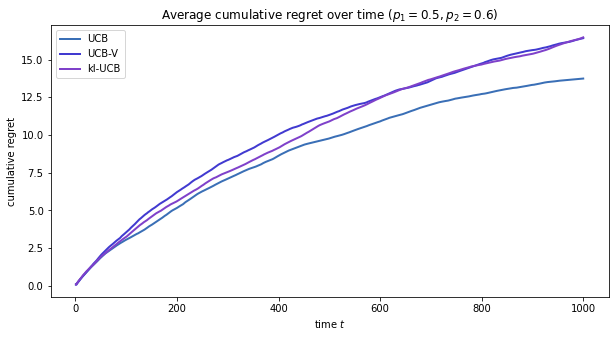

In [34]:
title = 'Average cumulative regret over time ($p_1 = 0.5, p_2 = 0.6$)'
plot_multiple_avg_regrets(regret_dict, save_fig=save_fig_flag, save_name='p2_6e_1', title=title)

In [35]:
probs1 = [0.1, 0.2]
bern_bandit1 = BernoulliBandit(K, probs1)
kl_ucb1 = kl_UCB(bern_bandit1)

In [36]:
kl_ucb1_regrets = []
kl_ucb1_cum_regrets = np.zeros((n,T))
for i in range(n):
    kl_ucb1.reset()
    kl_ucb1.run(T, n_run=i, ntot_run=n)
    kl_ucb1_regrets.append(kl_ucb1.regret)
    kl_ucb1_cum_regrets[i] = kl_ucb1.cum_regret

run 2/100 | running step 31/1000

run 2/100 | running step 655/1000

run 3/100 | running step 445/1000

run 4/100 | running step 154/1000

run 4/100 | running step 952/1000

run 5/100 | running step 653/1000

run 6/100 | running step 345/1000

run 7/100 | running step 64/1000

run 7/100 | running step 667/1000

run 8/100 | running step 336/1000

run 8/100 | running step 986/1000

run 9/100 | running step 716/1000

run 10/100 | running step 362/1000

run 100/100 | running step 1000/1000

In [37]:
regret_dict1 = {
    'UCB': [ucb1_cum_regrets, '#3A6FB6'],
    'UCB-V': [ucb_v1_cum_regrets, '#413AD0'],
    'kl-UCB': [kl_ucb1_cum_regrets, '#7F41CA'],
}

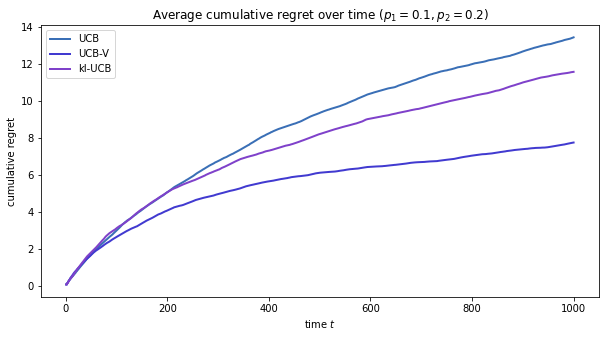

In [38]:
title = 'Average cumulative regret over time ($p_1 = 0.1, p_2 = 0.2$)'
plot_multiple_avg_regrets(regret_dict1, save_fig=save_fig_flag, save_name='p2_6e_2', title=title)

In [39]:
probs2 = [0.0, 0.1]
bern_bandit2 = BernoulliBandit(K, probs2)
kl_ucb2 = kl_UCB(bern_bandit2)

In [40]:
kl_ucb2_regrets = []
kl_ucb2_cum_regrets = np.zeros((n,T))
for i in range(n):
    kl_ucb2.reset()
    kl_ucb2.run(T, n_run=i, ntot_run=n)
    kl_ucb2_regrets.append(kl_ucb2.regret)
    kl_ucb2_cum_regrets[i] = kl_ucb2.cum_regret

run 2/100 | running step 35/1000

run 2/100 | running step 534/1000

run 3/100 | running step 317/1000

run 3/100 | running step 865/1000

run 4/100 | running step 450/1000

run 4/100 | running step 732/1000

run 5/100 | running step 280/1000

run 100/100 | running step 1000/1000

In [41]:
regret_dict2 = {
    'UCB': [ucb2_cum_regrets, '#3A6FB6'],
    'UCB-V': [ucb_v2_cum_regrets, '#413AD0'],
    'kl-UCB': [kl_ucb2_cum_regrets, '#7F41CA'],
}

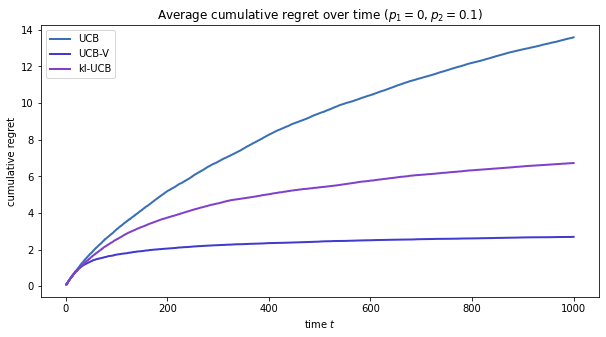

In [42]:
title = 'Average cumulative regret over time ($p_1 = 0, p_2 = 0.1$)'
plot_multiple_avg_regrets(regret_dict2, save_fig=save_fig_flag, save_name='p2_6e_3', title=title)